In [8]:
using Plots

In [16]:
# Parameters
L = 1.0
Nx = 101
dx = L/(Nx-1)
c = 1.0
T = 30.0
dt = 0.01
gamma = 0.0
gamma3 = 0.0
Nt = Int(T/dt)
x = range(0,L,length=Nx)
f = 3.0
A = 1.0

@assert c*dt/dx <= 1 "CFL condition violated!"
println(c*dt/dx)

# Initial conditions
u0(x) = 0.0
v0(x) = 0.0

# Boundary forcing
g(t) = A * sin(f*2π*t)
g_dot(t) = A * f*2π*cos(f*2π*t)

# Initialize solution array
u = zeros(Nx, Nt+1)
u[:,1] .= u0.(x)
u[:,2] .= u[:,1] .+ dt .* v0.(x)

# Apply BCs at first two steps
u[1,1] = 0.0
u[1,2] = 0.0
u[end,1] = 0.0
u[end,2] = 0.0

# Time stepping
for n in 2:Nt
    for i in 2:Nx-1
        u[i,n+1] = 2u[i,n] - u[i,n-1] + (c*dt/dx)^2*(u[i+1,n] - 2u[i,n] + u[i-1,n]) -
                    dt*gamma*(u[i,n] - u[i,n-1]) - gamma3*(1/dt)*(u[i,n] - u[i,n-1])^3 #+ dt^2 * g(dt * (n + 1))
    end
    u[1, n+1] = u[1,n] + (c*dt/(dx))*(u[2,n]-u[1,n]) + dt * g_dot(dt * n)
    #u[1, n+1] = g(dt * (n + 1))
    u[end,n+1] = 0.0
end

1.0


[ Info: Saved animation to /home/kamilj/Documents/git_repos/TW3715TU-2025-ShallowWaters/wave_equation.gif


Plots.AnimatedGif("/home/kamilj/Documents/git_repos/TW3715TU-2025-ShallowWaters/wave_equation.gif")
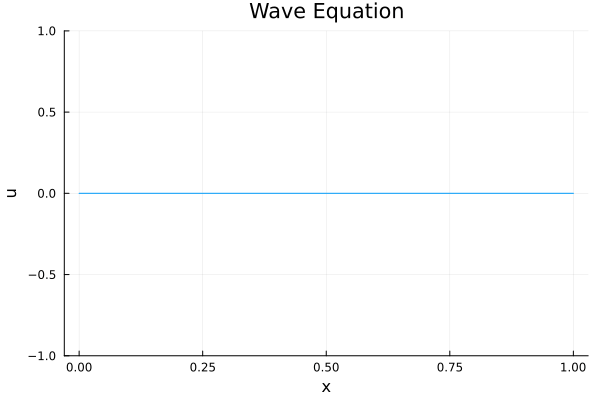

In [17]:
#Plotting the solution
anim = @animate for n in 1:1:Nt+1
    plot(x, u[:,n], xlabel="x", ylabel="u", ylims = (-1.0, 1.0), title="Wave Equation", legend=false)
end

gif(anim, "wave_equation.gif", fps=10)